<a href="https://colab.research.google.com/github/erikjskie/ensemblemerge_manuscript/blob/main/supplementary_Fig5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## set environment

In [ ]:
### install R packages ###
install.packages("devtools")
if (!requireNamespace("BiocManager", quietly = TRUE))
    install.packages("BiocManager")
BiocManager::install(c("SummarizedExperiment", "SingleCellExperiment", "knitr", "LoomExperiment", "batchelor"))
devtools::install_github("immunogenomics/harmony")
devtools::install_github('theislab/kBET')
devtools::install_version("Seurat", version = "4.0.1")
remotes::install_github('satijalab/seurat-wrappers@66e6e5096e1d6291cb5a735f3e266336c16e80c4')
devtools::install_github("cellgeni/sceasy")
install.packages("rliger")
install.packages("reticulate")
install.packages("SparseM")
install.packages("ArgumentCheck")
install.packages("ggpubr")
### load in python packages (if not installed, can be installed by package)
system("pip3 install scanpy")
system("pip3 install scanorama")
system("pip3 install bbknn")
system("pip3 install pynndescent")
system("pip3 install leidenalg")
system("pip3 install scvi-tools")
devtools::install_github("erikjskie/ensemblemerge")
devtools::install_github('gongx030/scmetrics@b26a37c7e8b2f50b58f7b14e7f4748a805a1cf80', quiet = FALSE, ref = 'master')
devtools::reload(pkgload::inst("scmetrics"))

In [ ]:
library(ensemblemerge)
library(scmetrics)
library(Seurat)
library(dplyr)
library(SeuratWrappers)
library(magrittr)
library(ggplot2)
library(ggpubr)

## testing ensemblemerge on dataset Vilani 2017 with Harmony, Seurat, BBKNN



In [ ]:
#@title loading data
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_1.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_1.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
#data = test
data <- as.Seurat(data, data = NULL)
#Idents(data) = "batch"
#data <- subset(data, downsample = 250)
data

An object of class Seurat 
20583 features across 576 samples within 1 assay 
Active assay: originalexp (20583 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running scVI results
params = setParams(method = "scVI", return = "Seurat")
scVI= Merge(params, data)
scVI <- RunUMAP(scVI, reduction = "scvi", dims = 1:10, seed.use = 1)
scVI <- FindNeighbors(scVI, reduction = 'umap', dims = 1:2, verbose = FALSE)
scVI <- FindClusters(scVI, algorithm = 3, resolution = 0.01, verbose = FALSE)
scVI$cluster <- Idents(scVI)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

[1] "Normalizing data"
[1] "finding variable features"


Centering and scaling data matrix

07:02:30 UMAP embedding parameters a = 0.9922 b = 1.112

07:02:30 Read 576 rows and found 20 numeric columns

07:02:30 Using Annoy for neighbor search, n_neighbors = 30

07:02:30 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

07:02:30 Writing NN index file to temp file /tmp/RtmpCMUgaa/file67291d197d

07:02:30 Searching Annoy index using 1 thread, search_k = 3000

07:02:30 Annoy recall = 100%

07:02:31 Commencing smooth kNN distance calibration using 1 thread

07:02:32 Initializing from normalized Laplacian + noise

07:02:32 Commencing optimization for 500 epochs, with 24194 positive edges

07:02:34 Optimization finished

Centering and scaling data matrix

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)
scVI = as.SingleCellExperiment(scVI)
test = as.SingleCellExperiment(test)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN", "scVI")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN, scVI)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.855 | resolution=1.000e-03*

cluster_cells | ARI=0.855 | resolution=1.194e-03

cluster_cells | ARI=0.855 | resolution=1.425e-03

cluster_cells | ARI=0.855 | resolution=1.701e-03

cluster_cells | ARI=0.855 | resolution=2.031e-03

cluster_cells | ARI=0.855 | resolution=2.424e-03

cluster_cells | ARI=0.855 | resolution=2.894e-03

cluster_cells | ARI=0.855 | resolution=3.455e-03

cluster_cells | ARI=0.855 | resolution=4.125e-03

cluster_cells | ARI=0.855 | resolution=4.924e-03

cluster_cells | ARI=0.855 | resolution=5.878e-03

cluster_cells | ARI=0.855 | resolution=7.017e-03

cluster_cells | ARI=0.855 | resolution=8.377e-03

cluster_cells | ARI=0.855 | resolution=1.000e-02

cluster_cells | ARI=0.855 | resolution=1.194e-02

cluster_cells | ARI=0.855 | resolution=1.425e-02

cluster_cells | ARI=0.855 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Uncorrected,0.7803294,NMI,Uncorrected
scVI,0.7773729,NMI,scVI
EnsembleMerge,0.7303019,NMI,EnsembleMerge
Seurat,0.6886438,NMI,Seurat
Harmony,0.6841818,NMI,Harmony
BBKNN,0.5180885,NMI,BBKNN
Uncorrected1,0.8550613,ARI_Cell,Uncorrected
scVI1,0.8528149,ARI_Cell,scVI
EnsembleMerge1,0.7553269,ARI_Cell,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

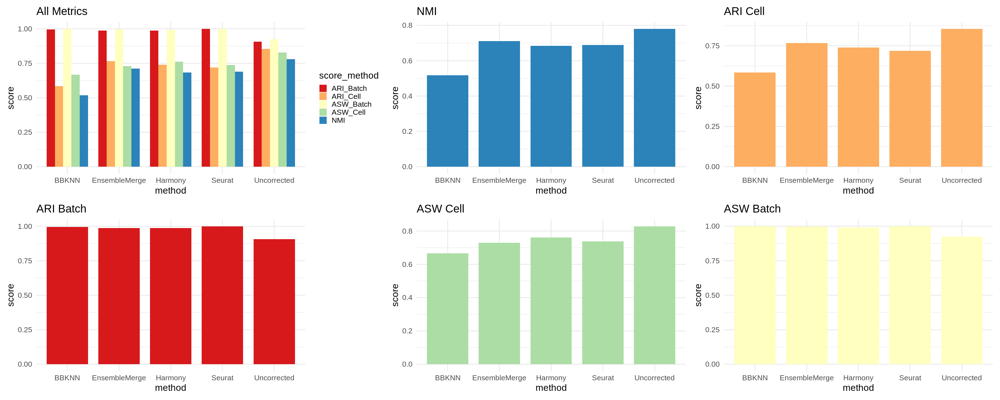

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

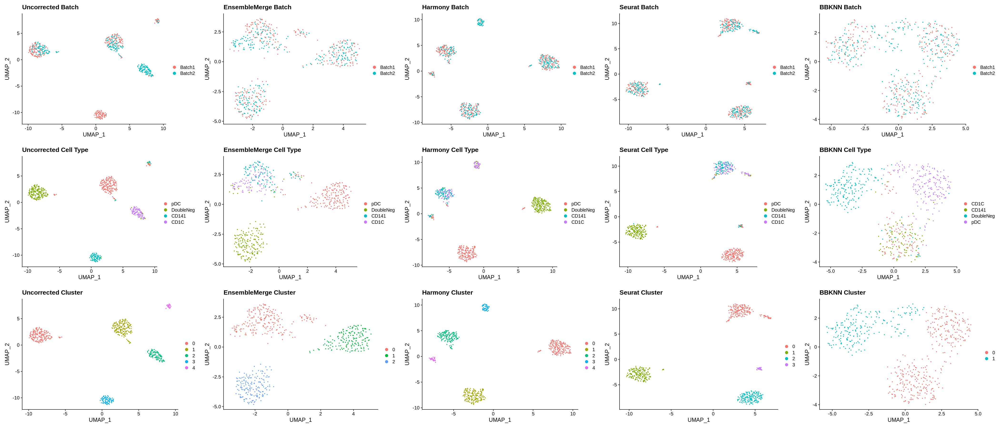

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Han 2018 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_2.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_2.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
#data <- subset(data, downsample = 1000)
data

An object of class Seurat 
15006 features across 2000 samples within 1 assay 
Active assay: originalexp (15006 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)
test = as.SingleCellExperiment(test)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.560 | resolution=1.000e-03

cluster_cells | ARI=0.560 | resolution=1.194e-03

cluster_cells | ARI=0.560 | resolution=1.425e-03

cluster_cells | ARI=0.560 | resolution=1.701e-03

cluster_cells | ARI=0.560 | resolution=2.031e-03

cluster_cells | ARI=0.560 | resolution=2.424e-03

cluster_cells | ARI=0.560 | resolution=2.894e-03

cluster_cells | ARI=0.560 | resolution=3.455e-03

cluster_cells | ARI=0.560 | resolution=4.125e-03

cluster_cells | ARI=0.560 | resolution=4.924e-03

cluster_cells | ARI=0.560 | resolution=5.878e-03

cluster_cells | ARI=0.560 | resolution=7.017e-03

cluster_cells | ARI=0.560 | resolution=8.377e-03

cluster_cells | ARI=0.560 | resolution=1.000e-02

cluster_cells | ARI=0.605 | resolution=1.194e-02*

cluster_cells | ARI=0.602 | resolution=1.425e-02

cluster_cells | ARI=0.578 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.8140526,NMI,EnsembleMerge
Harmony,0.7161256,NMI,Harmony
Uncorrected,0.7038048,NMI,Uncorrected
Seurat,0.6916720,NMI,Seurat
BBKNN,0.6303296,NMI,BBKNN
EnsembleMerge1,0.7651376,ARI_Cell,EnsembleMerge
Seurat1,0.6298234,ARI_Cell,Seurat
Harmony1,0.6241569,ARI_Cell,Harmony
Uncorrected1,0.6053187,ARI_Cell,Uncorrected


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

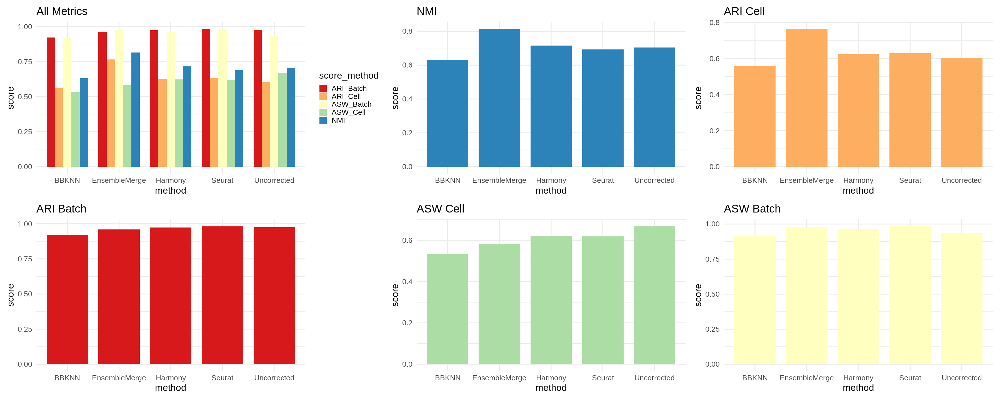

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

In [ ]:
BBKNN@meta.data$CellType = factor(BBKNN@meta.data$CellType %>% as.vector(), levels = c("T-cell", "NK", "B-cell", "Monocyte", "Macrophage", "Dendritic", "Endothelial", "Smooth-muscle", "Neutrophil", "Stromal", "Epithelial"))

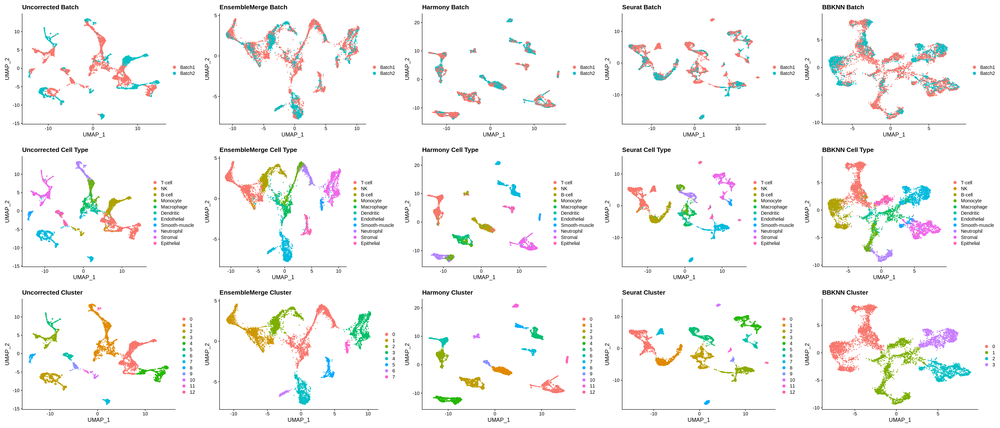

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Chen 2020 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_3.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_3.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
data

An object of class Seurat 
5000 features across 11320 samples within 1 assay 
Active assay: RNA (5000 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat", batch = "Batch")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat", batch = "Batch")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat", batch = "Batch")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat", batch = "Batch")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "Group",
  batch_field = "Batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.085 | resolution=1.000e-03*

cluster_cells | ARI=0.085 | resolution=1.194e-03

cluster_cells | ARI=0.085 | resolution=1.425e-03

cluster_cells | ARI=0.085 | resolution=1.701e-03

cluster_cells | ARI=0.085 | resolution=2.031e-03

cluster_cells | ARI=0.085 | resolution=2.424e-03

cluster_cells | ARI=0.085 | resolution=2.894e-03

cluster_cells | ARI=0.085 | resolution=3.455e-03

cluster_cells | ARI=0.085 | resolution=4.125e-03

cluster_cells | ARI=0.085 | resolution=4.924e-03

cluster_cells | ARI=0.085 | resolution=5.878e-03

cluster_cells | ARI=0.085 | resolution=7.017e-03

cluster_cells | ARI=0.085 | resolution=8.377e-03

cluster_cells | ARI=0.085 | resolution=1.000e-02

cluster_cells | ARI=0.085 | resolution=1.194e-02

cluster_cells | ARI=0.085 | resolution=1.425e-02

cluster_cells | ARI=0.085 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Seurat,0.18632607,NMI,Seurat
Harmony,0.18128046,NMI,Harmony
EnsembleMerge,0.17928928,NMI,EnsembleMerge
BBKNN,0.17759643,NMI,BBKNN
Uncorrected,0.17138939,NMI,Uncorrected
Seurat1,0.10493042,ARI_Cell,Seurat
Harmony1,0.10414999,ARI_Cell,Harmony
BBKNN1,0.09977488,ARI_Cell,BBKNN
EnsembleMerge1,0.09726748,ARI_Cell,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from UMAP__ to UMAP_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to UMAP_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC__ to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to PC_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from UMAP__ to UMAP_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to UMAP_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC__ to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting 

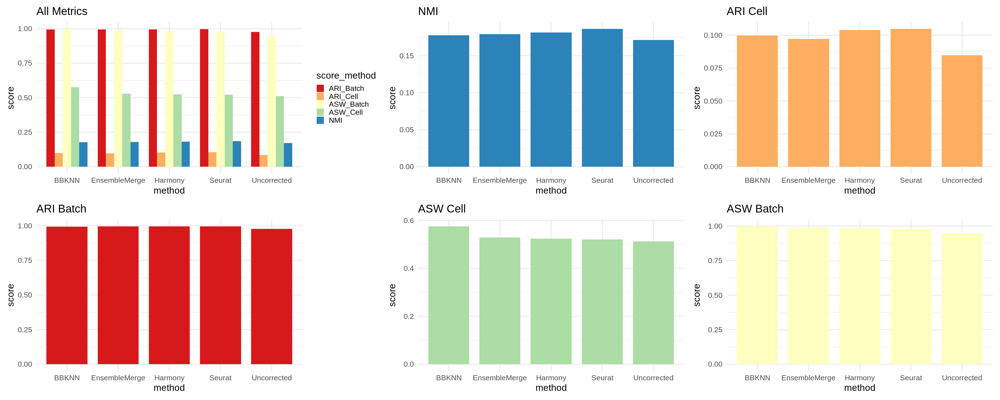

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

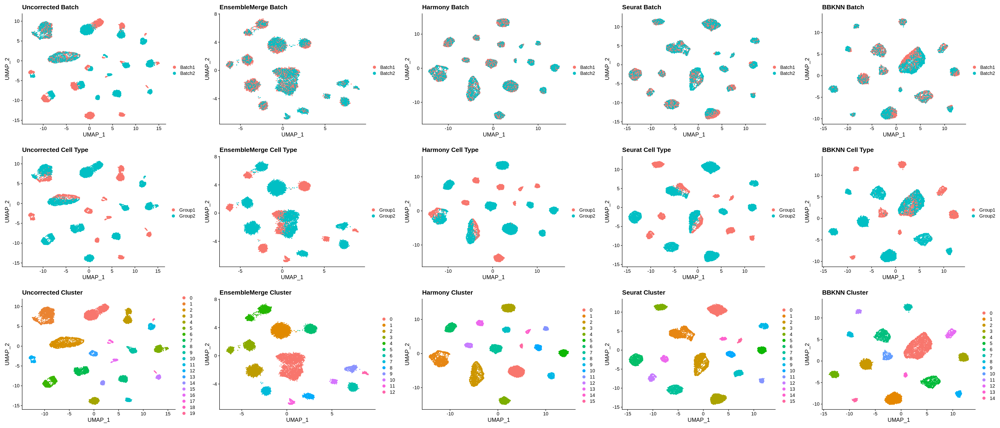

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "Batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "Group"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "Batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "Group"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "Batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "Group"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "Batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "Group"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "Batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "Group"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Hemberg Panc with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_4.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_4.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
#data <- subset(data, downsample = 3000)
data

An object of class Seurat 
15558 features across 14767 samples within 1 assay 
Active assay: originalexp (15558 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)
test = as.SingleCellExperiment(test)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.337 | resolution=1.000e-03

cluster_cells | ARI=0.337 | resolution=1.194e-03

cluster_cells | ARI=0.337 | resolution=1.425e-03

cluster_cells | ARI=0.337 | resolution=1.701e-03

cluster_cells | ARI=0.351 | resolution=2.031e-03

cluster_cells | ARI=0.351 | resolution=2.424e-03

cluster_cells | ARI=0.351 | resolution=2.894e-03

cluster_cells | ARI=0.351 | resolution=3.455e-03

cluster_cells | ARI=0.351 | resolution=4.125e-03

cluster_cells | ARI=0.351 | resolution=4.924e-03

cluster_cells | ARI=0.351 | resolution=5.878e-03

cluster_cells | ARI=0.351 | resolution=7.017e-03

cluster_cells | ARI=0.351 | resolution=8.377e-03

cluster_cells | ARI=0.351 | resolution=1.000e-02

cluster_cells | ARI=0.353 | resolution=1.194e-02*

cluster_cells | ARI=0.313 | resolution=1.425e-02

cluster_cells | ARI=0.329 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.8827027,NMI,EnsembleMerge
Harmony,0.8437198,NMI,Harmony
Seurat,0.7996764,NMI,Seurat
BBKNN,0.7316553,NMI,BBKNN
Uncorrected,0.5413380,NMI,Uncorrected
EnsembleMerge1,0.9434584,ARI_Cell,EnsembleMerge
Harmony1,0.8838166,ARI_Cell,Harmony
BBKNN1,0.8637987,ARI_Cell,BBKNN
Seurat1,0.8402617,ARI_Cell,Seurat


In [ ]:
write.csv(scores, file = "14767_cells_scores_d4.csv")

In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

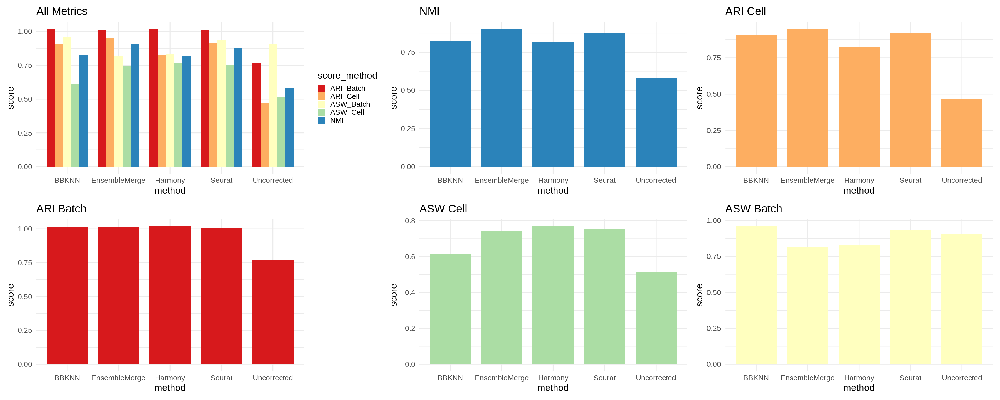

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

In [ ]:
BBKNN@meta.data$CellType = factor(BBKNN@meta.data$CellType %>% as.vector(), levels = c("acinar", "beta", "delta", "stellate", "ductal", "alpha", "epsilon",
"gamma", "endothelial", "macrophage", "schwann", "mast", "t_cell", "mesenchymal", "MHC class II"))

In [ ]:
BBKNN@meta.data$CellType %>% head()

[1] acinar acinar acinar acinar acinar acinar
15 Levels: acinar beta delta stellate ductal alpha epsilon ... MHC class II

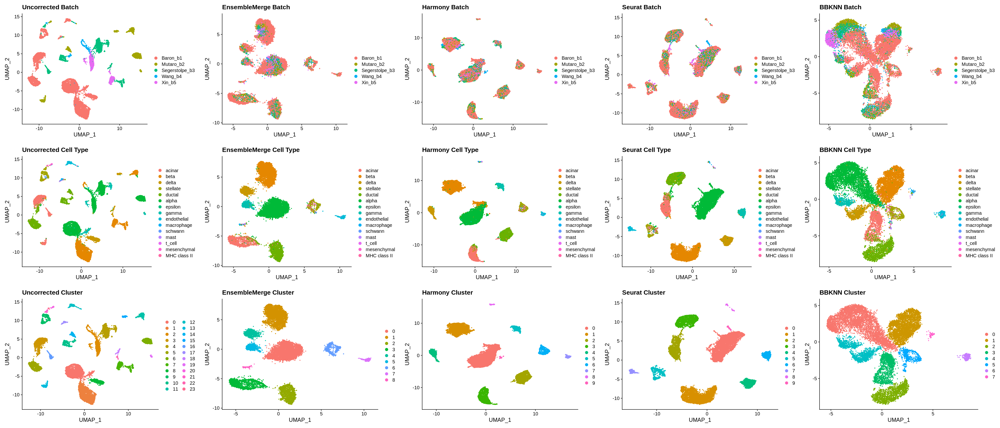

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

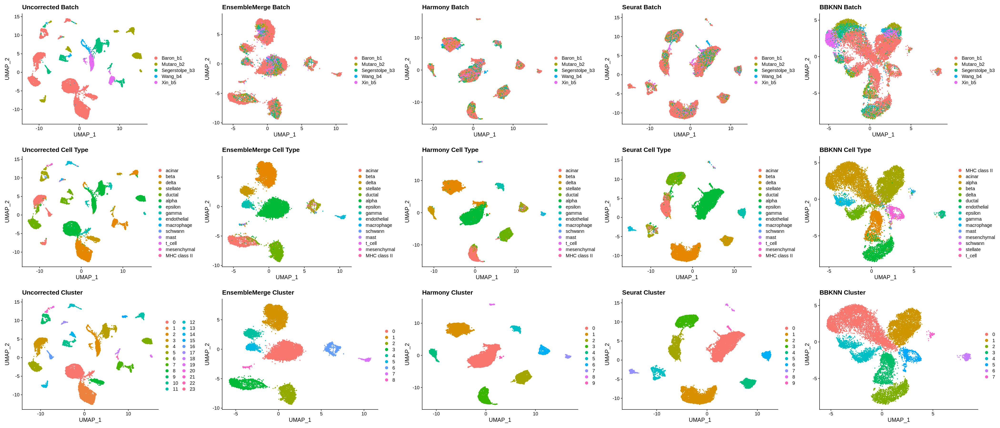

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset PBMC with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_5.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_5.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
data

An object of class Seurat 
23309 features across 15476 samples within 1 assay 
Active assay: originalexp (23309 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)
test = as.SingleCellExperiment(test)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.422 | resolution=1.000e-03

cluster_cells | ARI=0.422 | resolution=1.194e-03

cluster_cells | ARI=0.422 | resolution=1.425e-03

cluster_cells | ARI=0.422 | resolution=1.701e-03

cluster_cells | ARI=0.422 | resolution=2.031e-03

cluster_cells | ARI=0.422 | resolution=2.424e-03

cluster_cells | ARI=0.422 | resolution=2.894e-03

cluster_cells | ARI=0.422 | resolution=3.455e-03

cluster_cells | ARI=0.422 | resolution=4.125e-03

cluster_cells | ARI=0.422 | resolution=4.924e-03

cluster_cells | ARI=0.422 | resolution=5.878e-03

cluster_cells | ARI=0.422 | resolution=7.017e-03

cluster_cells | ARI=0.422 | resolution=8.377e-03

cluster_cells | ARI=0.422 | resolution=1.000e-02

cluster_cells | ARI=0.422 | resolution=1.194e-02

cluster_cells | ARI=0.422 | resolution=1.425e-02

cluster_cells | ARI=0.397 | resolution=1.701e-02

cluster_cells | A

,score,score_method,method
,<dbl>,<chr>,<chr>
Seurat,0.8549623,NMI,Seurat
BBKNN,0.8313820,NMI,BBKNN
Harmony,0.8166854,NMI,Harmony
EnsembleMerge,0.7591916,NMI,EnsembleMerge
Uncorrected,0.5648735,NMI,Uncorrected
Seurat1,0.8780971,ARI_Cell,Seurat
Harmony1,0.8506412,ARI_Cell,Harmony
BBKNN1,0.8333546,ARI_Cell,BBKNN
EnsembleMerge1,0.7333005,ARI_Cell,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

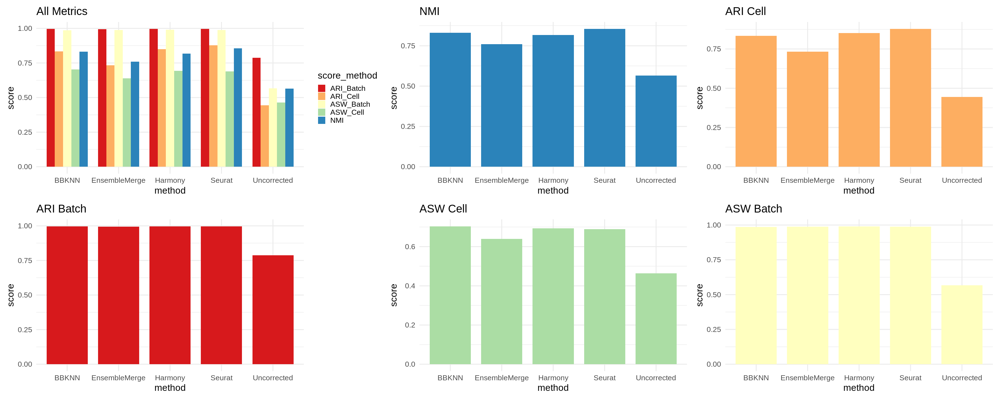

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

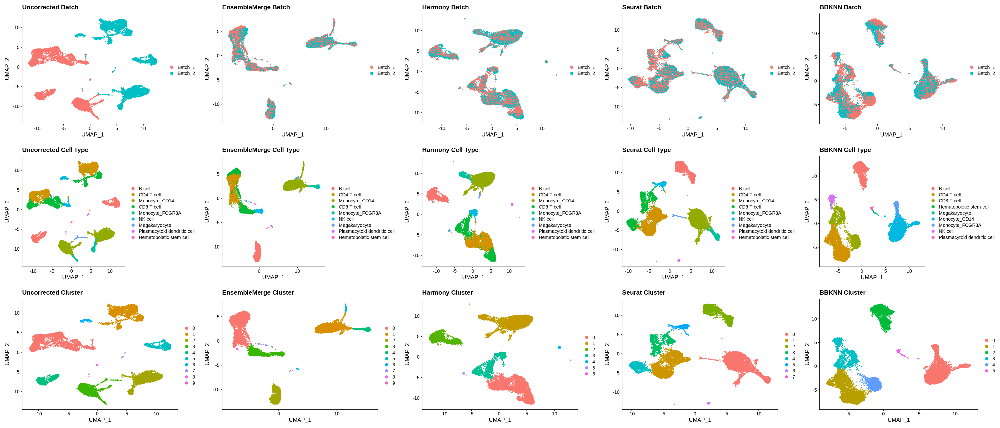

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset 293t_Jurkat with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_6.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_6.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
data

An object of class Seurat 
21474 features across 9531 samples within 1 assay 
Active assay: RNA (21474 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.728 | resolution=1.000e-03*

cluster_cells | ARI=0.728 | resolution=1.194e-03

cluster_cells | ARI=0.728 | resolution=1.425e-03

cluster_cells | ARI=0.728 | resolution=1.701e-03

cluster_cells | ARI=0.728 | resolution=2.031e-03

cluster_cells | ARI=0.728 | resolution=2.424e-03

cluster_cells | ARI=0.728 | resolution=2.894e-03

cluster_cells | ARI=0.677 | resolution=3.455e-03

cluster_cells | ARI=0.677 | resolution=4.125e-03

cluster_cells | ARI=0.677 | resolution=4.924e-03

cluster_cells | ARI=0.677 | resolution=5.878e-03

cluster_cells | ARI=0.677 | resolution=7.017e-03

cluster_cells | ARI=0.677 | resolution=8.377e-03

cluster_cells | ARI=0.677 | resolution=1.000e-02

cluster_cells | ARI=0.677 | resolution=1.194e-02

cluster_cells | ARI=0.677 | resolution=1.425e-02

cluster_cells | ARI=0.677 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Harmony,0.93363473,NMI,Harmony
EnsembleMerge,0.93229237,NMI,EnsembleMerge
BBKNN,0.90911368,NMI,BBKNN
Uncorrected,0.63517505,NMI,Uncorrected
Seurat,0.05147484,NMI,Seurat
Harmony1,0.97917507,ARI_Cell,Harmony
EnsembleMerge1,0.97895217,ARI_Cell,EnsembleMerge
BBKNN1,0.95149386,ARI_Cell,BBKNN
Uncorrected1,0.72813976,ARI_Cell,Uncorrected


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

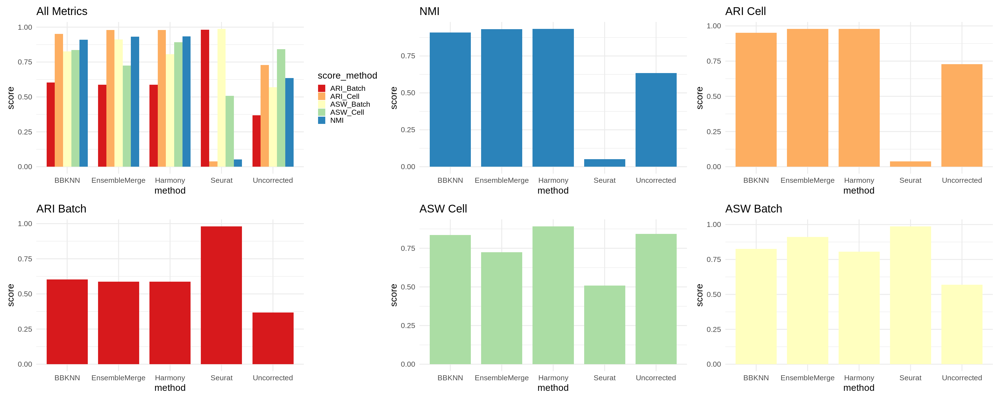

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

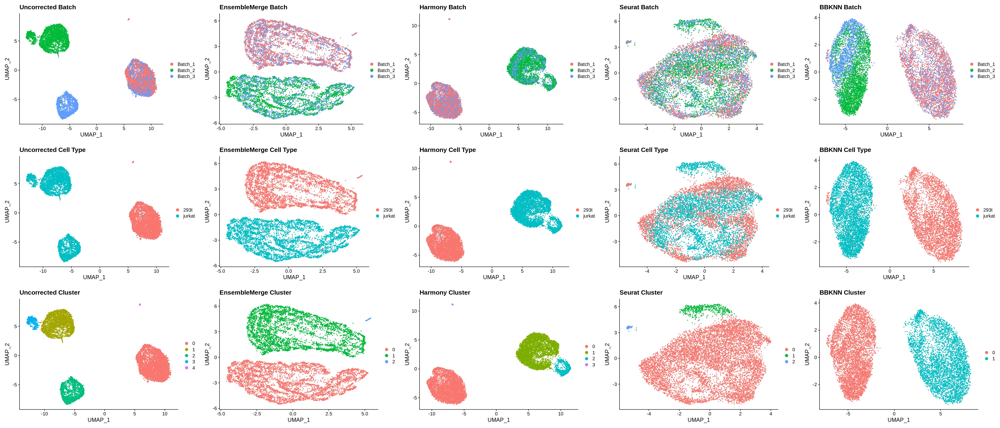

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Hemberg Retina with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_7.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_7.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
data <- subset(data, downsample = 5000)
data

An object of class Seurat 
12333 features across 10000 samples within 1 assay 
Active assay: RNA (12333 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.502 | resolution=1.000e-03*

cluster_cells | ARI=0.502 | resolution=1.194e-03

cluster_cells | ARI=0.502 | resolution=1.425e-03

cluster_cells | ARI=0.502 | resolution=1.701e-03

cluster_cells | ARI=0.502 | resolution=2.031e-03

cluster_cells | ARI=0.502 | resolution=2.424e-03

cluster_cells | ARI=0.502 | resolution=2.894e-03

cluster_cells | ARI=0.502 | resolution=3.455e-03

cluster_cells | ARI=0.502 | resolution=4.125e-03

cluster_cells | ARI=0.502 | resolution=4.924e-03

cluster_cells | ARI=0.502 | resolution=5.878e-03

cluster_cells | ARI=0.502 | resolution=7.017e-03

cluster_cells | ARI=0.502 | resolution=8.377e-03

cluster_cells | ARI=0.502 | resolution=1.000e-02

cluster_cells | ARI=0.502 | resolution=1.194e-02

cluster_cells | ARI=0.502 | resolution=1.425e-02

cluster_cells | ARI=0.502 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.6147200,NMI,EnsembleMerge
Harmony,0.5378232,NMI,Harmony
BBKNN,0.5372634,NMI,BBKNN
Seurat,0.5362330,NMI,Seurat
Uncorrected,0.5295095,NMI,Uncorrected
EnsembleMerge1,0.5481154,ARI_Cell,EnsembleMerge
Seurat1,0.5096915,ARI_Cell,Seurat
Harmony1,0.5084649,ARI_Cell,Harmony
Uncorrected1,0.5019087,ARI_Cell,Uncorrected


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

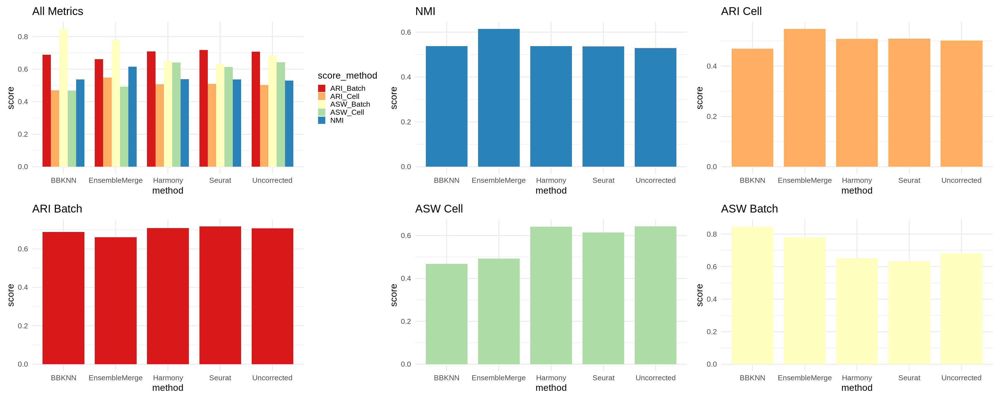

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

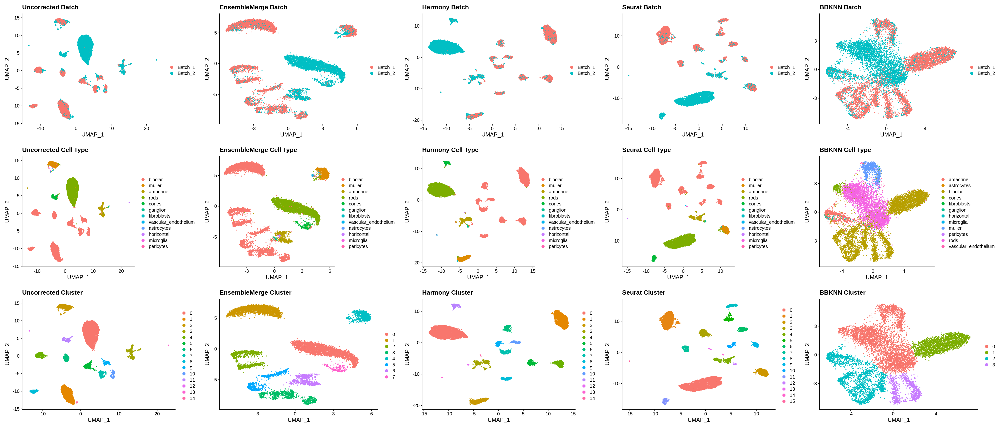

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Saunders 2018 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_8_DS.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_8_DS.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
data <- subset(data, downsample = 5000)
data

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)
test = as.SingleCellExperiment(test)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.311 | resolution=1.000e-03

cluster_cells | ARI=0.311 | resolution=1.194e-03

cluster_cells | ARI=0.311 | resolution=1.425e-03

cluster_cells | ARI=0.311 | resolution=1.701e-03

cluster_cells | ARI=0.311 | resolution=2.031e-03

cluster_cells | ARI=0.311 | resolution=2.424e-03

cluster_cells | ARI=0.311 | resolution=2.894e-03

cluster_cells | ARI=0.311 | resolution=3.455e-03

cluster_cells | ARI=0.311 | resolution=4.125e-03

cluster_cells | ARI=0.311 | resolution=4.924e-03

cluster_cells | ARI=0.311 | resolution=5.878e-03

cluster_cells | ARI=0.342 | resolution=7.017e-03*

cluster_cells | ARI=0.342 | resolution=8.377e-03

cluster_cells | ARI=0.342 | resolution=1.000e-02

cluster_cells | ARI=0.342 | resolution=1.194e-02

cluster_cells | ARI=0.289 | resolution=1.425e-02

cluster_cells | ARI=0.289 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.5936532,NMI,EnsembleMerge
Harmony,0.5613566,NMI,Harmony
Seurat,0.5399771,NMI,Seurat
BBKNN,0.4920697,NMI,BBKNN
Uncorrected,0.4199875,NMI,Uncorrected
BBKNN1,0.6901117,ARI_Cell,BBKNN
EnsembleMerge1,0.6633345,ARI_Cell,EnsembleMerge
Harmony1,0.5273003,ARI_Cell,Harmony
Seurat1,0.4447243,ARI_Cell,Seurat


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

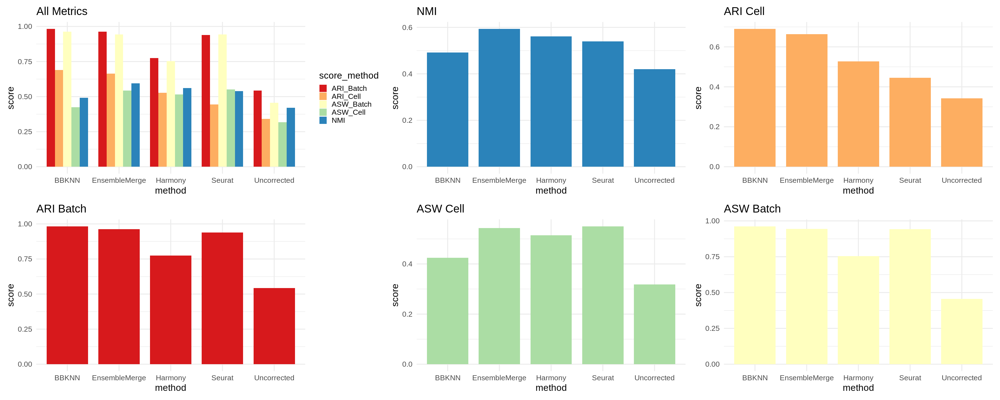

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

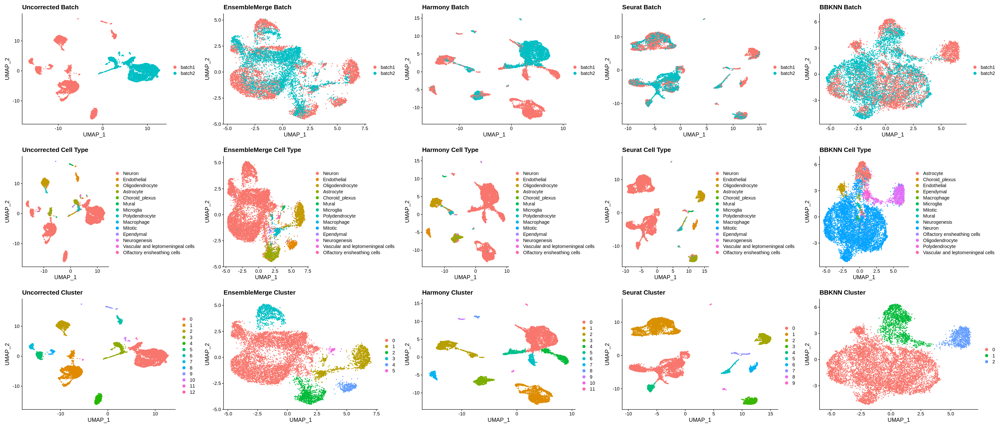

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset HCA Blood with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_9_DS.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_9_DS.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

An object of class Seurat 
18969 features across 10000 samples within 1 assay 
Active assay: RNA (18969 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.029 | resolution=1.000e-03

cluster_cells | ARI=0.029 | resolution=1.194e-03

cluster_cells | ARI=0.029 | resolution=1.425e-03

cluster_cells | ARI=0.029 | resolution=1.701e-03

cluster_cells | ARI=0.029 | resolution=2.031e-03

cluster_cells | ARI=0.029 | resolution=2.424e-03

cluster_cells | ARI=0.029 | resolution=2.894e-03

cluster_cells | ARI=0.029 | resolution=3.455e-03

cluster_cells | ARI=0.029 | resolution=4.125e-03

cluster_cells | ARI=0.029 | resolution=4.924e-03

cluster_cells | ARI=0.029 | resolution=5.878e-03

cluster_cells | ARI=0.024 | resolution=7.017e-03

cluster_cells | ARI=0.276 | resolution=8.377e-03

cluster_cells | ARI=0.276 | resolution=1.000e-02

cluster_cells | ARI=0.276 | resolution=1.194e-02

cluster_cells | ARI=0.276 | resolution=1.425e-02

cluster_cells | ARI=0.276 | resolution=1.701e-02

cluster_cells | A

,score,score_method,method
,<dbl>,<chr>,<chr>
Uncorrected,0.19321158,NMI,Uncorrected
Harmony,0.04855604,NMI,Harmony
BBKNN,0.04435541,NMI,BBKNN
EnsembleMerge,0.04279768,NMI,EnsembleMerge
Seurat,0.03955292,NMI,Seurat
Uncorrected1,0.27762384,ARI_Cell,Uncorrected
Harmony1,0.07047367,ARI_Cell,Harmony
BBKNN1,0.06346816,ARI_Cell,BBKNN
EnsembleMerge1,0.06327713,ARI_Cell,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

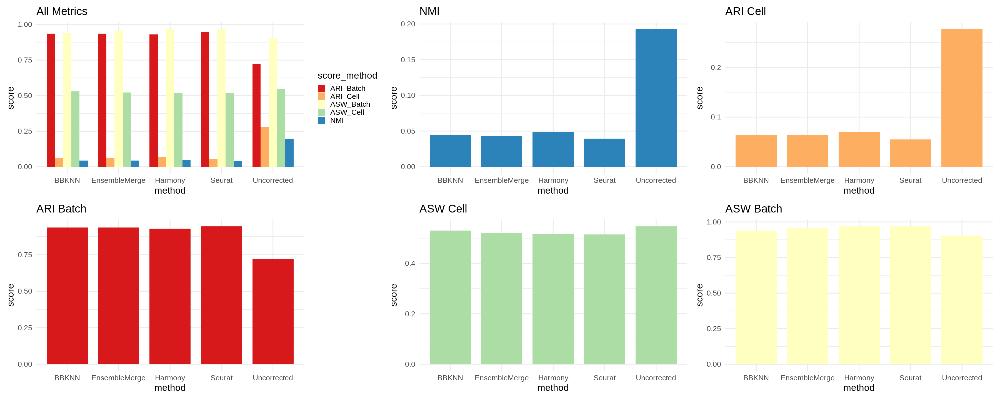

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

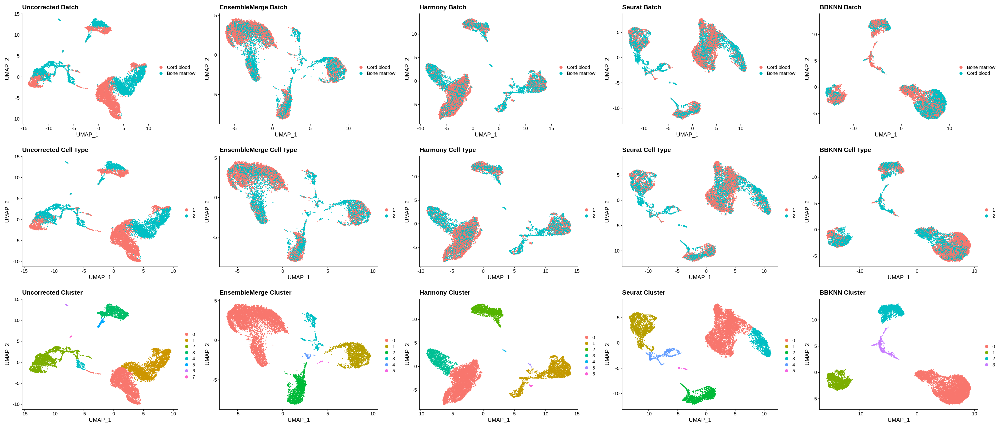

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Paul 2015 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_10.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_10.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
data

An object of class Seurat 
3467 features across 4649 samples within 1 assay 
Active assay: RNA (3467 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "CellType",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.188 | resolution=1.000e-03

cluster_cells | ARI=0.188 | resolution=1.194e-03

cluster_cells | ARI=0.188 | resolution=1.425e-03

cluster_cells | ARI=0.188 | resolution=1.701e-03

cluster_cells | ARI=0.188 | resolution=2.031e-03

cluster_cells | ARI=0.188 | resolution=2.424e-03

cluster_cells | ARI=0.188 | resolution=2.894e-03

cluster_cells | ARI=0.188 | resolution=3.455e-03

cluster_cells | ARI=0.356 | resolution=4.125e-03

cluster_cells | ARI=0.438 | resolution=4.924e-03

cluster_cells | ARI=0.438 | resolution=5.878e-03

cluster_cells | ARI=0.438 | resolution=7.017e-03

cluster_cells | ARI=0.438 | resolution=8.377e-03

cluster_cells | ARI=0.438 | resolution=1.000e-02

cluster_cells | ARI=0.438 | resolution=1.194e-02

cluster_cells | ARI=0.438 | resolution=1.425e-02

cluster_cells | ARI=0.438 | resolution=1.701e-02

cluster_cells | A

,score,score_method,method
,<dbl>,<chr>,<chr>
Uncorrected,0.5015480,NMI,Uncorrected
BBKNN,0.4479983,NMI,BBKNN
Seurat,0.4465866,NMI,Seurat
Harmony,0.4374391,NMI,Harmony
EnsembleMerge,0.4050576,NMI,EnsembleMerge
Seurat1,0.5151085,ARI_Cell,Seurat
Uncorrected1,0.4968630,ARI_Cell,Uncorrected
Harmony1,0.4942610,ARI_Cell,Harmony
BBKNN1,0.4917660,ARI_Cell,BBKNN


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

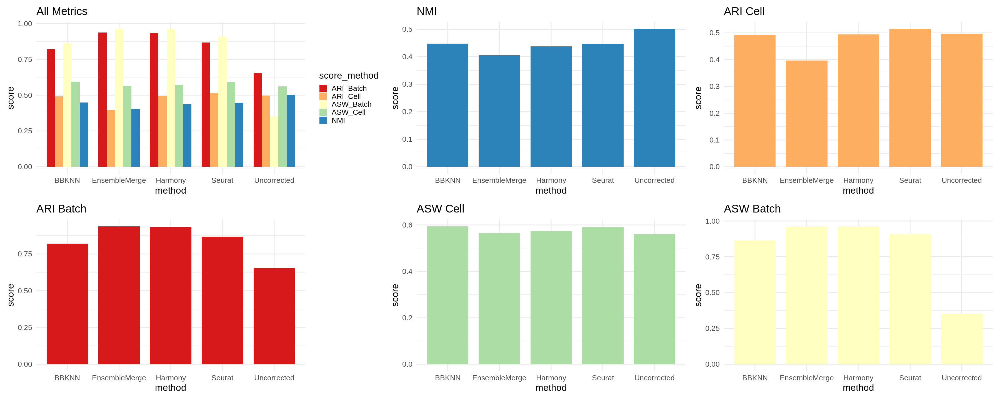

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

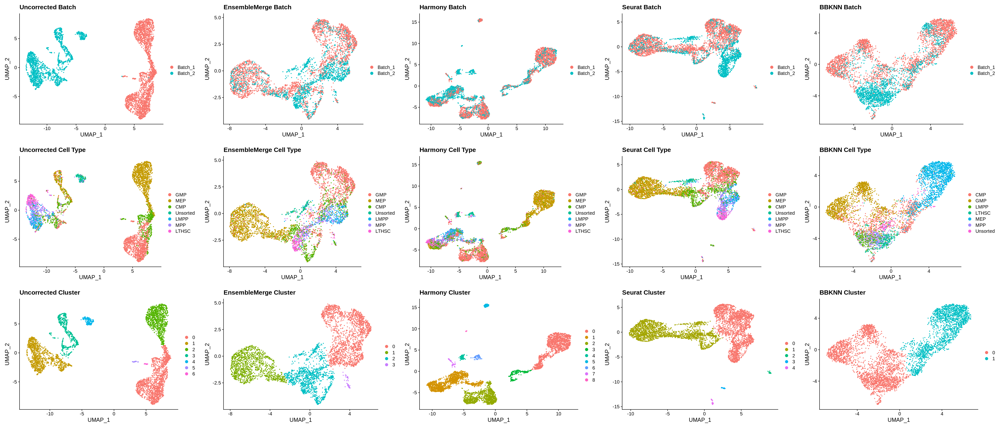

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batchlb"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "CellType"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batchlb"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "CellType"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batchlb"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "CellType"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batchlb"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "CellType"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batchlb"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "CellType"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Zilionis 2019 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=retina_version=20210406b/se.rds")
data = readRDS("/content/gongx030/datasets/dataset=retina_version=20210406b/se.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
#data <- CreateSeuratObject(counts = assays(data)$counts, meta.data = colData(data))
data = as.Seurat(data, data = NULL)
Idents(data) = "batch"
data <- subset(data, downsample = 2500)
data

An object of class Seurat 
10155 features across 10000 samples within 1 assay 
Active assay: RNA (10155 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(test)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names[2]
names(nmi_list) = names[2]
names(ari_cell_list) = names[2]
names(ari_batch_list) = names[2]
names(asw_cell_list) = names[2]
names(asw_batch_list) = names[2]

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.232 | resolution=1.000e-03

cluster_cells | ARI=0.232 | resolution=1.194e-03

cluster_cells | ARI=0.232 | resolution=1.425e-03

cluster_cells | ARI=0.232 | resolution=1.701e-03

cluster_cells | ARI=0.232 | resolution=2.031e-03

cluster_cells | ARI=0.232 | resolution=2.424e-03

cluster_cells | ARI=0.660 | resolution=2.894e-03

cluster_cells | ARI=0.660 | resolution=3.455e-03

cluster_cells | ARI=0.660 | resolution=4.125e-03

cluster_cells | ARI=0.660 | resolution=4.924e-03

cluster_cells | ARI=0.660 | resolution=5.878e-03

cluster_cells | ARI=0.834 | resolution=7.017e-03*

cluster_cells | ARI=0.834 | resolution=8.377e-03

cluster_cells | ARI=0.728 | resolution=1.000e-02

cluster_cells | ARI=0.689 | resolution=1.194e-02

cluster_cells | ARI=0.689 | resolution=1.425e-02

cluster_cells | ARI=0.728 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.7243325,NMI,EnsembleMerge
EnsembleMerge1,0.8339062,ARI_Cell,EnsembleMerge
EnsembleMerge2,0.7808869,ARI_Batch,EnsembleMerge
EnsembleMerge3,0.5270073,ASW_Cell,EnsembleMerge
EnsembleMerge4,0.9927735,ASW_Batch,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

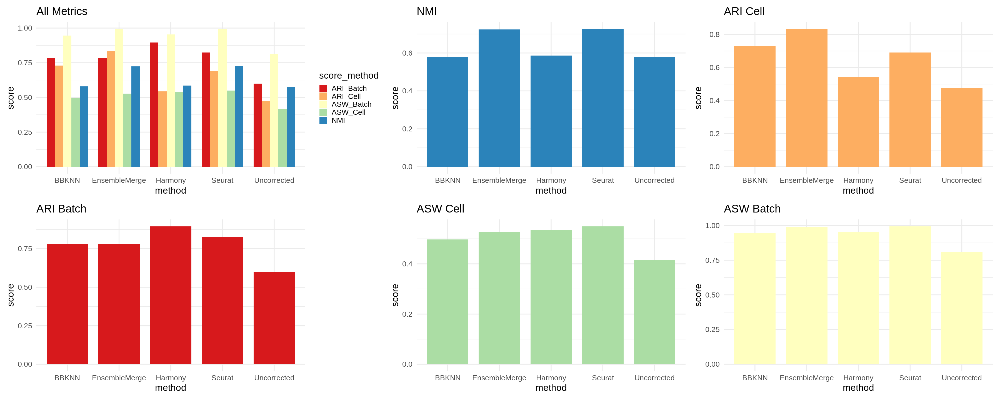

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

In [ ]:
BBKNN@meta.data$cell_type = factor(BBKNN@meta.data$cell_type %>% as.vector(), levels = c("macroglia", "bipolar", "rods", "amacrine", "horizontal", "cones", "retinal_ganglion", "endothelium", "microglia", "fibroblasts"))
uncorrected@meta.data$batch  = uncorrected@meta.data$batch  %>% as.vector()
uncorrected@meta.data[which(uncorrected@meta.data$batch == "dataset=Menon_Microfluidics_version=20210323a"), "batch"] = "Menon_Microfluidics"
uncorrected@meta.data[which(uncorrected@meta.data$batch == "dataset=Menon_SeqWell_version=20210323a"), "batch"] = "Menon_SeqWell"
uncorrected@meta.data[which(uncorrected@meta.data$batch == "dataset=macosko_version=20210324a"), "batch"] = "Macosko"
uncorrected@meta.data[which(uncorrected@meta.data$batch == "dataset=shekhar_version=20210323a"), "batch"] = "Shekhar_Microfluidics"
uncorrected@meta.data$batch   = uncorrected@meta.data$batch  %>% as.factor()
test@meta.data$batch   = test@meta.data$batch  %>% as.vector()
test@meta.data[which(test@meta.data$batch == "dataset=Menon_Microfluidics_version=20210323a"), "batch"] = "Menon_Microfluidics"
test@meta.data[which(test@meta.data$batch == "dataset=Menon_SeqWell_version=20210323a"), "batch"] = "Menon_SeqWell"
test@meta.data[which(test@meta.data$batch == "dataset=macosko_version=20210324a"), "batch"] = "Macosko"
test@meta.data[which(test@meta.data$batch == "dataset=shekhar_version=20210323a"), "batch"] = "Shekhar_Microfluidics"
test@meta.data$batch   = test@meta.data$batch  %>% as.factor()
Harmony@meta.data$batch   = Harmony@meta.data$batch  %>% as.vector()
Harmony@meta.data[which(Harmony@meta.data$batch == "dataset=Menon_Microfluidics_version=20210323a"), "batch"] = "Menon_Microfluidics"
Harmony@meta.data[which(Harmony@meta.data$batch == "dataset=Menon_SeqWell_version=20210323a"), "batch"] = "Menon_SeqWell"
Harmony@meta.data[which(Harmony@meta.data$batch == "dataset=macosko_version=20210324a"), "batch"] = "Macosko"
Harmony@meta.data[which(Harmony@meta.data$batch == "dataset=shekhar_version=20210323a"), "batch"] = "Shekhar_Microfluidics"
Harmony@meta.data$batch   = Harmony@meta.data$batch  %>% as.factor()
Seurat@meta.data$batch   = Seurat@meta.data$batch  %>% as.vector()
Seurat@meta.data[which(Seurat@meta.data$batch == "dataset=Menon_Microfluidics_version=20210323a"), "batch"] = "Menon_Microfluidics"
Seurat@meta.data[which(Seurat@meta.data$batch == "dataset=Menon_SeqWell_version=20210323a"), "batch"] = "Menon_SeqWell"
Seurat@meta.data[which(Seurat@meta.data$batch == "dataset=macosko_version=20210324a"), "batch"] = "Macosko"
Seurat@meta.data[which(Seurat@meta.data$batch == "dataset=shekhar_version=20210323a"), "batch"] = "Shekhar_Microfluidics"
Seurat@meta.data$batch   = Seurat@meta.data$batch  %>% as.factor()
BBKNN@meta.data$batch  = BBKNN@meta.data$batch  %>% as.vector()
BBKNN@meta.data[which(BBKNN@meta.data$batch == "dataset=Menon_Microfluidics_version=20210323a"), "batch"] = "Menon_Microfluidics"
BBKNN@meta.data[which(BBKNN@meta.data$batch == "dataset=Menon_SeqWell_version=20210323a"), "batch"] = "Menon_SeqWell"
BBKNN@meta.data[which(BBKNN@meta.data$batch == "dataset=macosko_version=20210324a"), "batch"] = "Macosko"
BBKNN@meta.data[which(BBKNN@meta.data$batch == "dataset=shekhar_version=20210323a"), "batch"] = "Shekhar_Microfluidics"
BBKNN@meta.data$batch  = BBKNN@meta.data$batch  %>% as.factor()

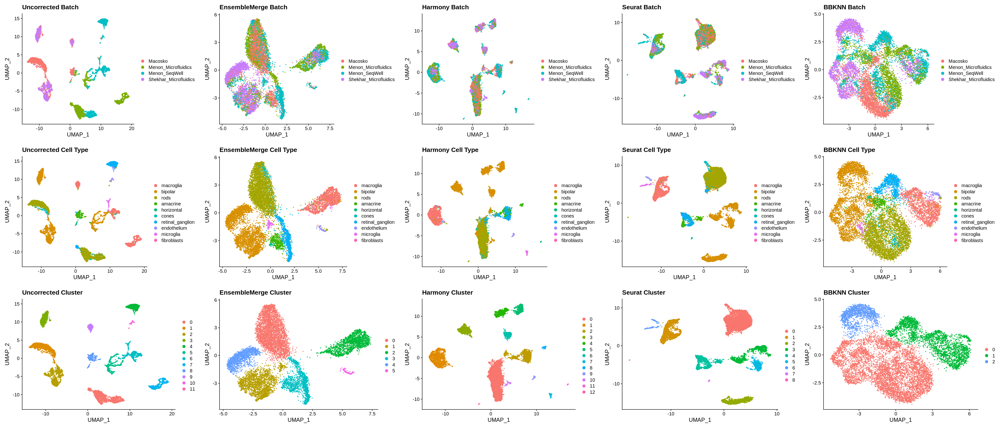

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Human/mouse Retina with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=Zilionis_version=20210329c/se.rds")
data = readRDS("/content/gongx030/datasets/dataset=Zilionis_version=20210329c/se.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

An object of class Seurat 
15519 features across 10000 samples within 1 assay 
Active assay: RNA (15519 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.420 | resolution=1.000e-03

cluster_cells | ARI=0.420 | resolution=1.194e-03

cluster_cells | ARI=0.420 | resolution=1.425e-03

cluster_cells | ARI=0.420 | resolution=1.701e-03

cluster_cells | ARI=0.420 | resolution=2.031e-03

cluster_cells | ARI=0.420 | resolution=2.424e-03

cluster_cells | ARI=0.420 | resolution=2.894e-03

cluster_cells | ARI=0.420 | resolution=3.455e-03

cluster_cells | ARI=0.420 | resolution=4.125e-03

cluster_cells | ARI=0.527 | resolution=4.924e-03*

cluster_cells | ARI=0.527 | resolution=5.878e-03

cluster_cells | ARI=0.527 | resolution=7.017e-03

cluster_cells | ARI=0.527 | resolution=8.377e-03

cluster_cells | ARI=0.527 | resolution=1.000e-02

cluster_cells | ARI=0.527 | resolution=1.194e-02

cluster_cells | ARI=0.527 | resolution=1.425e-02

cluster_cells | ARI=0.527 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Seurat,0.7802559,NMI,Seurat
EnsembleMerge,0.7650837,NMI,EnsembleMerge
Harmony,0.7560074,NMI,Harmony
Uncorrected,0.6340231,NMI,Uncorrected
BBKNN,0.5851699,NMI,BBKNN
Harmony1,0.8570596,ARI_Cell,Harmony
EnsembleMerge1,0.7225837,ARI_Cell,EnsembleMerge
Seurat1,0.7164283,ARI_Cell,Seurat
BBKNN1,0.6388565,ARI_Cell,BBKNN


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

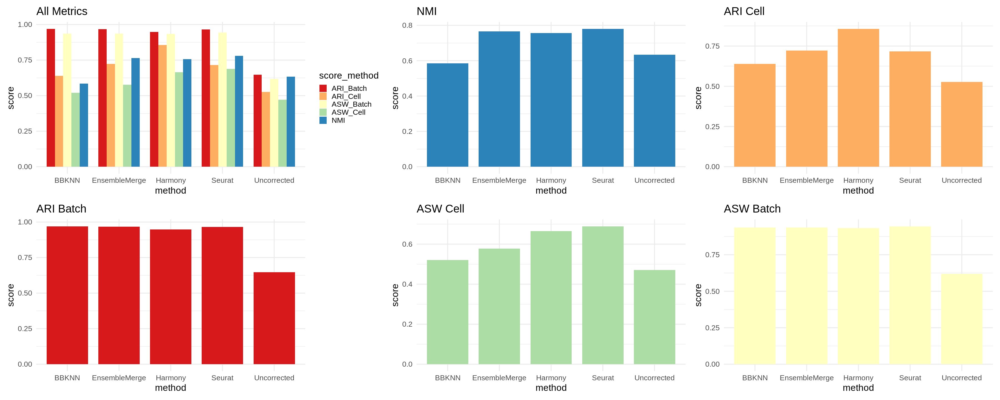

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

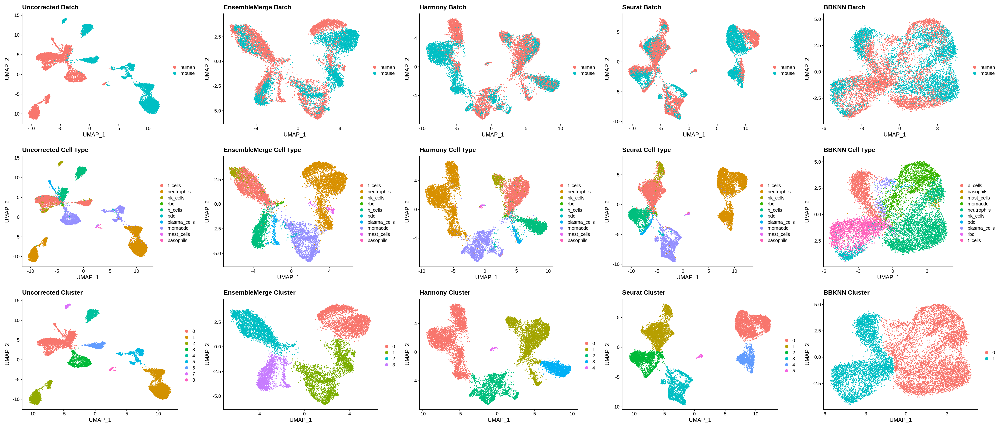

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Polanski 2019 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_5.rds")
data = readRDS("/content/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_5.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
data <- subset(data, downsample = 5000)
data

Warning message:
“The column names of thecounts matrix is NULL. Setting cell names to cell_columnidx (e.g 'cell_1').”


An object of class Seurat 
23309 features across 10000 samples within 1 assay 
Active assay: RNA (23309 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.428 | resolution=1.000e-03

cluster_cells | ARI=0.428 | resolution=1.194e-03

cluster_cells | ARI=0.428 | resolution=1.425e-03

cluster_cells | ARI=0.428 | resolution=1.701e-03

cluster_cells | ARI=0.428 | resolution=2.031e-03

cluster_cells | ARI=0.428 | resolution=2.424e-03

cluster_cells | ARI=0.428 | resolution=2.894e-03

cluster_cells | ARI=0.428 | resolution=3.455e-03

cluster_cells | ARI=0.428 | resolution=4.125e-03

cluster_cells | ARI=0.428 | resolution=4.924e-03

cluster_cells | ARI=0.428 | resolution=5.878e-03

cluster_cells | ARI=0.428 | resolution=7.017e-03

cluster_cells | ARI=0.428 | resolution=8.377e-03

cluster_cells | ARI=0.428 | resolution=1.000e-02

cluster_cells | ARI=0.428 | resolution=1.194e-02

cluster_cells | ARI=0.428 | resolution=1.425e-02

cluster_cells | ARI=0.452 | resolution=1.701e-02*

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
BBKNN,0.8567476,NMI,BBKNN
Seurat,0.8032297,NMI,Seurat
Harmony,0.7248118,NMI,Harmony
EnsembleMerge,0.7155130,NMI,EnsembleMerge
Uncorrected,0.5892086,NMI,Uncorrected
BBKNN1,0.8823403,ARI_Cell,BBKNN
Seurat1,0.8535977,ARI_Cell,Seurat
Harmony1,0.7107961,ARI_Cell,Harmony
EnsembleMerge1,0.6971280,ARI_Cell,EnsembleMerge


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

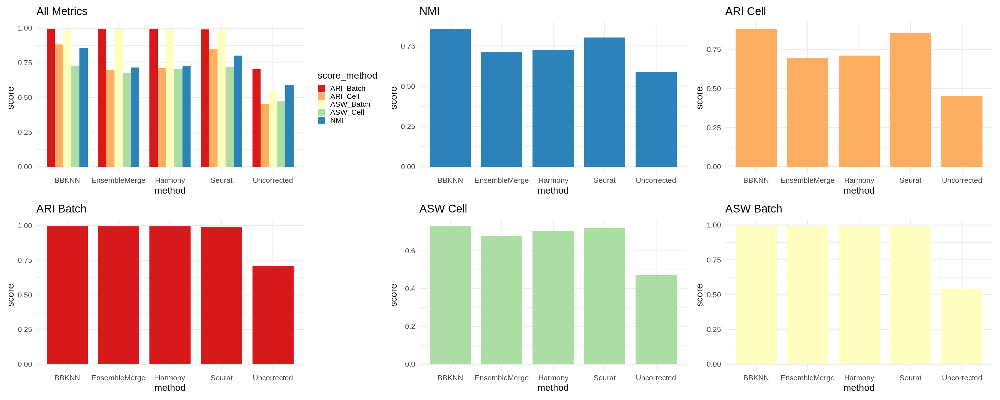

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

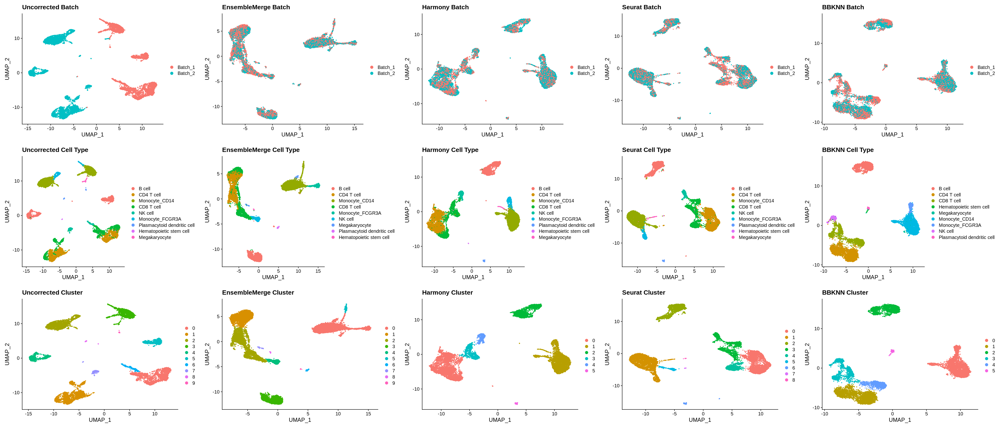

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Nestorowa 2016 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_10.rds")
data = readRDS("/content/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_10.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
#Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

Warning message:
“The column names of thecounts matrix is NULL. Setting cell names to cell_columnidx (e.g 'cell_1').”


An object of class Seurat 
3467 features across 4649 samples within 1 assay 
Active assay: RNA (3467 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.188 | resolution=1.000e-03

cluster_cells | ARI=0.188 | resolution=1.194e-03

cluster_cells | ARI=0.188 | resolution=1.425e-03

cluster_cells | ARI=0.188 | resolution=1.701e-03

cluster_cells | ARI=0.188 | resolution=2.031e-03

cluster_cells | ARI=0.188 | resolution=2.424e-03

cluster_cells | ARI=0.188 | resolution=2.894e-03

cluster_cells | ARI=0.188 | resolution=3.455e-03

cluster_cells | ARI=0.356 | resolution=4.125e-03

cluster_cells | ARI=0.438 | resolution=4.924e-03

cluster_cells | ARI=0.438 | resolution=5.878e-03

cluster_cells | ARI=0.438 | resolution=7.017e-03

cluster_cells | ARI=0.438 | resolution=8.377e-03

cluster_cells | ARI=0.438 | resolution=1.000e-02

cluster_cells | ARI=0.438 | resolution=1.194e-02

cluster_cells | ARI=0.438 | resolution=1.425e-02

cluster_cells | ARI=0.438 | resolution=1.701e-02

cluster_cells | A

,score,score_method,method
,<dbl>,<chr>,<chr>
Uncorrected,0.5015480,NMI,Uncorrected
BBKNN,0.4479983,NMI,BBKNN
Seurat,0.4465866,NMI,Seurat
Harmony,0.4374391,NMI,Harmony
EnsembleMerge,0.4068301,NMI,EnsembleMerge
Seurat1,0.5151085,ARI_Cell,Seurat
Uncorrected1,0.4968630,ARI_Cell,Uncorrected
Harmony1,0.4942610,ARI_Cell,Harmony
BBKNN1,0.4917660,ARI_Cell,BBKNN


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

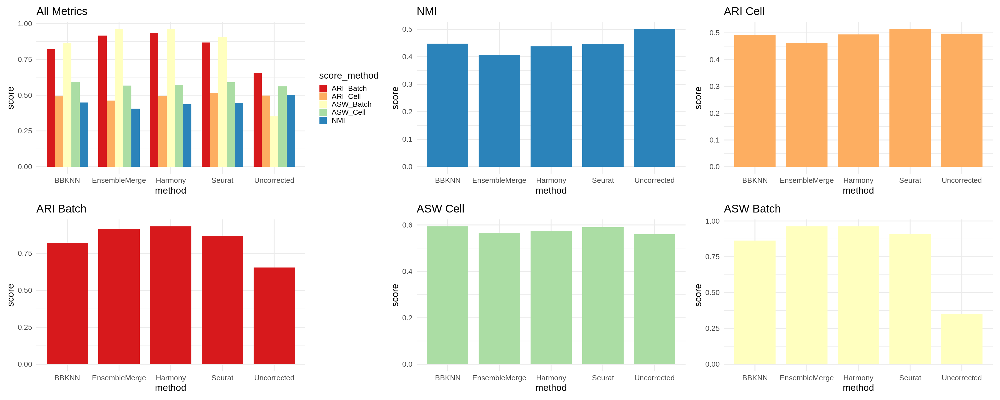

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

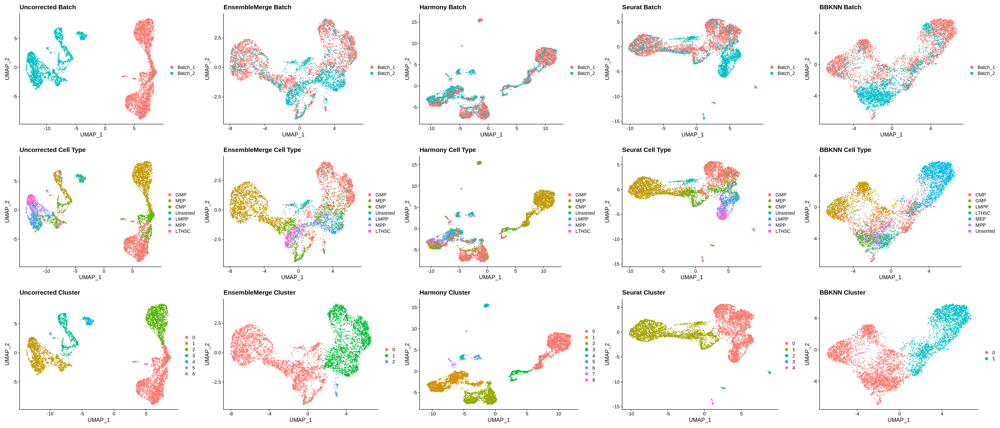

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Zheng 2017 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_6.rds")
data = readRDS("/content/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_6.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
#Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

Warning message:
“The column names of thecounts matrix is NULL. Setting cell names to cell_columnidx (e.g 'cell_1').”


An object of class Seurat 
21474 features across 9531 samples within 1 assay 
Active assay: RNA (21474 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.728 | resolution=1.000e-03*

cluster_cells | ARI=0.728 | resolution=1.194e-03

cluster_cells | ARI=0.728 | resolution=1.425e-03

cluster_cells | ARI=0.728 | resolution=1.701e-03

cluster_cells | ARI=0.728 | resolution=2.031e-03

cluster_cells | ARI=0.728 | resolution=2.424e-03

cluster_cells | ARI=0.728 | resolution=2.894e-03

cluster_cells | ARI=0.677 | resolution=3.455e-03

cluster_cells | ARI=0.677 | resolution=4.125e-03

cluster_cells | ARI=0.677 | resolution=4.924e-03

cluster_cells | ARI=0.677 | resolution=5.878e-03

cluster_cells | ARI=0.677 | resolution=7.017e-03

cluster_cells | ARI=0.677 | resolution=8.377e-03

cluster_cells | ARI=0.677 | resolution=1.000e-02

cluster_cells | ARI=0.677 | resolution=1.194e-02

cluster_cells | ARI=0.677 | resolution=1.425e-02

cluster_cells | ARI=0.677 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Harmony,0.93363473,NMI,Harmony
EnsembleMerge,0.93229237,NMI,EnsembleMerge
BBKNN,0.90970692,NMI,BBKNN
Uncorrected,0.63517505,NMI,Uncorrected
Seurat,0.05147484,NMI,Seurat
Harmony1,0.97917507,ARI_Cell,Harmony
EnsembleMerge1,0.97895217,ARI_Cell,EnsembleMerge
BBKNN1,0.95190333,ARI_Cell,BBKNN
Uncorrected1,0.72813976,ARI_Cell,Uncorrected


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

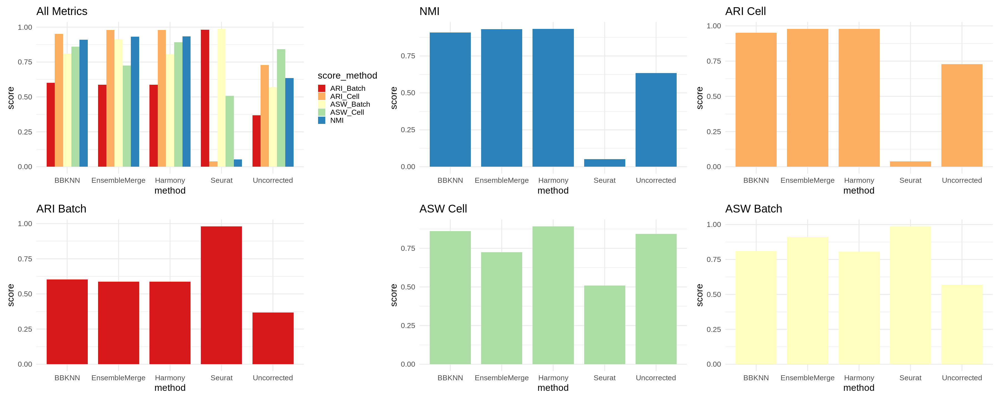

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

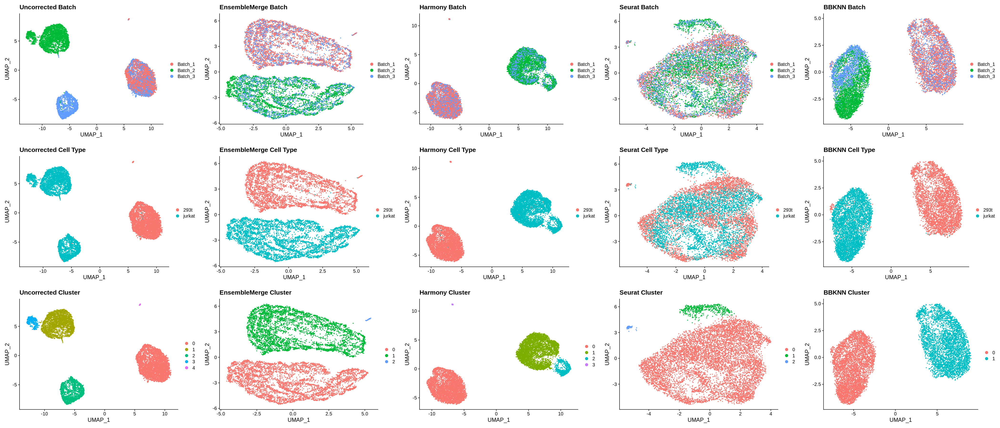

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Shekhar 2016 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_7.rds")
data = readRDS("/content/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_7.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

Warning message:
“The column names of thecounts matrix is NULL. Setting cell names to cell_columnidx (e.g 'cell_1').”


An object of class Seurat 
12333 features across 10000 samples within 1 assay 
Active assay: RNA (12333 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.502 | resolution=1.000e-03*

cluster_cells | ARI=0.502 | resolution=1.194e-03

cluster_cells | ARI=0.502 | resolution=1.425e-03

cluster_cells | ARI=0.502 | resolution=1.701e-03

cluster_cells | ARI=0.502 | resolution=2.031e-03

cluster_cells | ARI=0.502 | resolution=2.424e-03

cluster_cells | ARI=0.502 | resolution=2.894e-03

cluster_cells | ARI=0.502 | resolution=3.455e-03

cluster_cells | ARI=0.502 | resolution=4.125e-03

cluster_cells | ARI=0.502 | resolution=4.924e-03

cluster_cells | ARI=0.502 | resolution=5.878e-03

cluster_cells | ARI=0.502 | resolution=7.017e-03

cluster_cells | ARI=0.502 | resolution=8.377e-03

cluster_cells | ARI=0.502 | resolution=1.000e-02

cluster_cells | ARI=0.502 | resolution=1.194e-02

cluster_cells | ARI=0.502 | resolution=1.425e-02

cluster_cells | ARI=0.502 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.6147524,NMI,EnsembleMerge
Harmony,0.5378232,NMI,Harmony
BBKNN,0.5372634,NMI,BBKNN
Seurat,0.5362330,NMI,Seurat
Uncorrected,0.5295095,NMI,Uncorrected
EnsembleMerge1,0.5482727,ARI_Cell,EnsembleMerge
Seurat1,0.5096915,ARI_Cell,Seurat
Harmony1,0.5084649,ARI_Cell,Harmony
Uncorrected1,0.5019087,ARI_Cell,Uncorrected


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

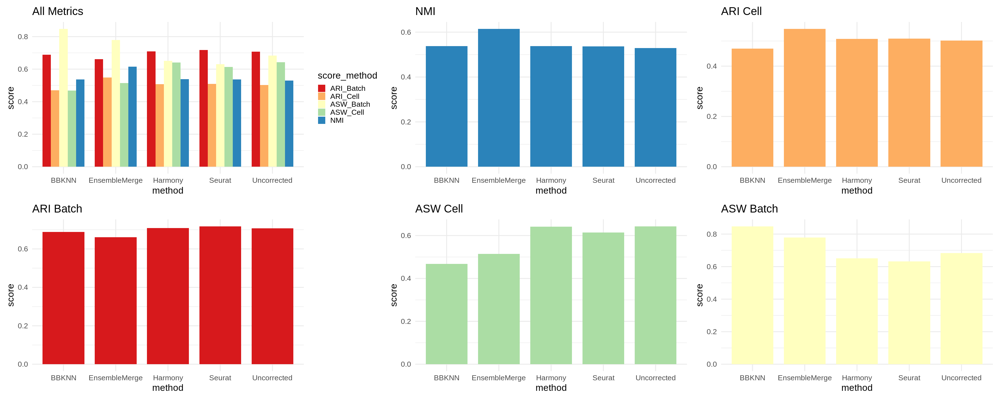

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

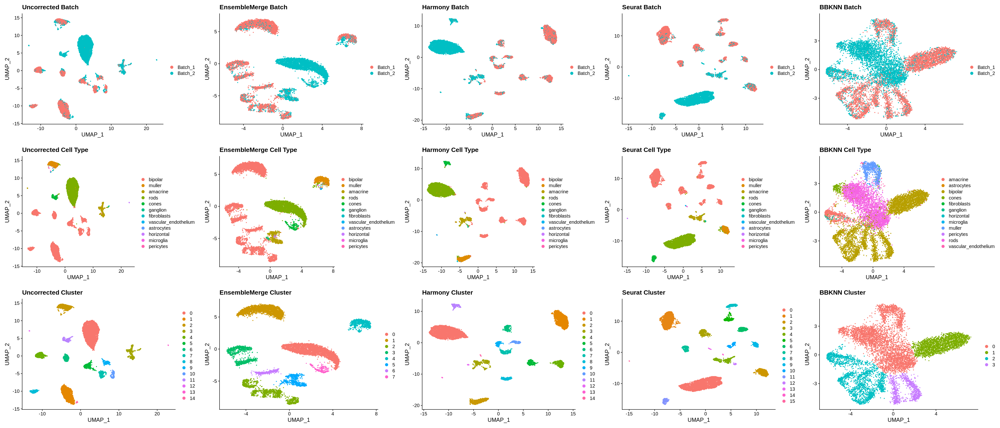

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset HBDC with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_1.rds")
data = readRDS("/content/gongx030/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_1.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
#Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.855 | resolution=1.000e-03*

cluster_cells | ARI=0.855 | resolution=1.194e-03

cluster_cells | ARI=0.855 | resolution=1.425e-03

cluster_cells | ARI=0.855 | resolution=1.701e-03

cluster_cells | ARI=0.855 | resolution=2.031e-03

cluster_cells | ARI=0.855 | resolution=2.424e-03

cluster_cells | ARI=0.855 | resolution=2.894e-03

cluster_cells | ARI=0.855 | resolution=3.455e-03

cluster_cells | ARI=0.855 | resolution=4.125e-03

cluster_cells | ARI=0.855 | resolution=4.924e-03

cluster_cells | ARI=0.855 | resolution=5.878e-03

cluster_cells | ARI=0.855 | resolution=7.017e-03

cluster_cells | ARI=0.855 | resolution=8.377e-03

cluster_cells | ARI=0.855 | resolution=1.000e-02

cluster_cells | ARI=0.855 | resolution=1.194e-02

cluster_cells | ARI=0.855 | resolution=1.425e-02

cluster_cells | ARI=0.855 | resolution=1.701e-02

cluster_cells | 

,score,score_method,method
,<dbl>,<chr>,<chr>
Uncorrected,0.7803294,NMI,Uncorrected
EnsembleMerge,0.7103068,NMI,EnsembleMerge
Seurat,0.6886438,NMI,Seurat
Harmony,0.6841818,NMI,Harmony
BBKNN,0.6131272,NMI,BBKNN
Uncorrected1,0.8550613,ARI_Cell,Uncorrected
EnsembleMerge1,0.7646391,ARI_Cell,EnsembleMerge
Harmony1,0.7396580,ARI_Cell,Harmony
Seurat1,0.7189500,ARI_Cell,Seurat


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

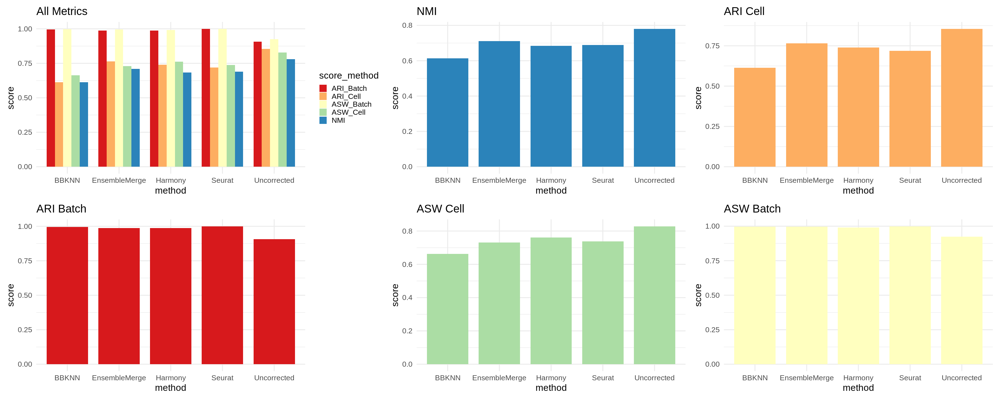

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

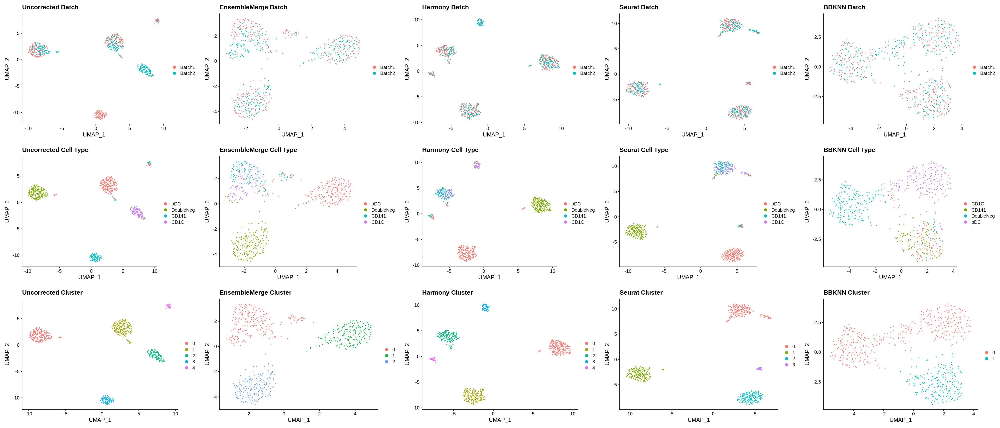

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)

## testing ensemblemerge on dataset Panc8 with Harmony, Seurat, BBKNN



In [ ]:
#@title Running Seurat, Harmony, BBKNN integration
setwd("/content")
system("wget -x -c -nH https://s3.msi.umn.edu/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_4_seurat_panc8.rds")
data = readRDS("/content/skiex003/datasets/dataset=JC_benchmark_scRNAseq_version=2021219a/dataset_4_seurat_panc8.rds")
data = as(data, "SingleCellExperiment")
keep_feature <- rowSums(counts(data) > 0) > 0
data <- data[keep_feature, ]
data <- as.Seurat(data, data = NULL)
#Idents(data) = "batch"
#data <- subset(data, downsample = 5000)
data

An object of class Seurat 
29340 features across 14890 samples within 1 assay 
Active assay: RNA (29340 features, 0 variable features)

In [ ]:
#@title running Ensemblemerge and Harmony, Seurat, BBKNN, and Uncorrected methods

#running uncorrected results
params = setParams(method = "Uncorrected", return = "Seurat")
uncorrected = Merge(params, data)
uncorrected <- RunUMAP(uncorrected, reduction = "pca", dims = 1:20, seed.use = 1)
uncorrected <- FindNeighbors(uncorrected, reduction = 'umap', dims = 1:2, verbose = FALSE)
uncorrected <- FindClusters(uncorrected, algorithm = 3, resolution = 0.01, verbose = FALSE)
uncorrected$cluster <- Idents(uncorrected)

#running Harmony results
params = setParams(method = "Harmony", return = "Seurat")
Harmony = Merge(params, data)
Harmony <- RunUMAP(Harmony, reduction = "harmony", dims = 1:20, seed.use = 1)
Harmony <- FindNeighbors(Harmony, reduction = 'umap', dims = 1:2, verbose = FALSE)
Harmony <- FindClusters(Harmony, algorithm = 3, resolution = 0.01, verbose = FALSE)
Harmony$cluster <- Idents(Harmony)

#running Seurat results
params = setParams(method = "Seurat", return = "Seurat")
Seurat = Merge(params, data)
Seurat <- RunUMAP(Seurat, reduction = "pca", dims = 1:20, seed.use = 1)
Seurat <- FindNeighbors(Seurat, reduction = 'umap', dims = 1:2, verbose = FALSE)
Seurat <- FindClusters(Seurat, algorithm = 3, resolution = 0.01, verbose = FALSE)
Seurat$cluster <- Idents(Seurat)

#running BBKNN results
params = setParams(method = "BBKNN", return = "Seurat")
BBKNN = Merge(params, data)
BBKNN <- RunUMAP(BBKNN, nn.name = "bbknn", seed.use = 1)
BBKNN <- FindNeighbors(BBKNN, reduction = 'umap', dims = 1:2, verbose = FALSE)
BBKNN <- FindClusters(BBKNN, algorithm = 3, resolution = 0.01, verbose = FALSE)
BBKNN$cluster <- Idents(BBKNN)

#running ensemblemerge results
test = EnsembleMerge(data, methods = c("Seurat", "Harmony", "Liger", "BBKNN", "Scanorama"), return = "Seurat", a = 3, b = 3)
test = RunUMAP(test, graph = "EnsembleMerge")
test <- FindNeighbors(test, reduction = 'umap', dims = 1:2, verbose = FALSE)
test <- FindClusters(test, algorithm = 3, resolution = 0.01, verbose = FALSE)

In [ ]:
#@title convert to SingleCellExpirement for metrics
uncorrected = as.SingleCellExperiment(uncorrected)
Seurat = as.SingleCellExperiment(Seurat)
Harmony = as.SingleCellExperiment(Harmony)
BBKNN = as.SingleCellExperiment(BBKNN)

In [ ]:
#@title Wuming pipeline ARI testing Ensemblemerge
config <- list(
  label_field = "cell_type",
  batch_field = "batch",
  n_neighbors = 15L,
  resolution_min = 1e-3,
  resolution_max = 1,
  resolution_length = 40L,
  metrics_max = c('ARI')
) %>%
  expand.grid(stringsAsFactors = FALSE)

ARGS<- config[1, ]

params <- new('ClusterLouvain', n_neighbors = ARGS[['n_neighbors']], resolution_min = ARGS[['resolution_min']], resolution_max = ARGS[['resolution_max']], resolution_length = ARGS[['resolution_length']])

r <- 'UMAP'

names = c("Uncorrected", "EnsembleMerge", "Seurat", "Harmony", "BBKNN")
i = 1

nmi_list = list()
ari_cell_list = list()
ari_batch_list = list()
asw_cell_list = list()
asw_batch_list = list()

for(tests in list(uncorrected, test, Seurat, Harmony, BBKNN)){
  tests <- suppressWarnings(cluster_cells(tests, params, reduction = r, label=  ARGS[['label_field']], cluster = 'cluster', metric = ARGS[['metrics_max']]))
  nmi <- metrics(tests, new('MetricsNMI'), label = ARGS[['label_field']], cluster = 'cluster')
  nmi_list = append(nmi_list, nmi)
  ari_cell <- metrics(tests, new('MetricsARI'), label = ARGS[['label_field']], cluster = 'cluster')
  ari_cell_list = append(ari_cell_list, ari_cell)
  ari_batch <- metrics(tests, new('MetricsARI'), label = ARGS[['batch_field']], cluster = 'cluster')
  ari_batch <- 1 - ari_batch
  ari_batch_list = append(ari_batch_list, ari_batch)
  asw_cell <- metrics(tests, new('MetricsASW'), label = ARGS[['label_field']], reduction = r)
  asw_cell <- (asw_cell + 1) / 2
  asw_cell_list = append(asw_cell_list, asw_cell)
  asw_batch <- metrics(tests, new('MetricsASW'), label = ARGS[['batch_field']], reduction = r)
  asw_batch <- 1 - abs(asw_batch)
  asw_batch_list = append(asw_batch_list, asw_batch)
  sprintf('%s Score:', names[i]) %>% message()
  sprintf('NMI: %.3f', nmi) %>% message()
  sprintf('ARI(cell): %.3f', ari_cell) %>% message()
  sprintf('ASW(cell): %.3f', asw_cell) %>% message()
  sprintf('ARI(batch): %.3f', ari_batch) %>% message()
  sprintf('ASW(batch): %.3f', asw_batch) %>% message()
  i = i + 1
}

names(ari_cell_list) = names
names(nmi_list) = names
names(ari_cell_list) = names
names(ari_batch_list) = names
names(asw_cell_list) = names
names(asw_batch_list) = names

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list = t(nmi_list)
ari_cell_list = t(ari_cell_list)
ari_batch_list = t(ari_batch_list)
asw_cell_list = t(asw_cell_list)
asw_batch_list = t(asw_batch_list)

colnames(ari_cell_list) = c("score")
colnames(nmi_list) = c("score")
colnames(ari_batch_list) = c("score")
colnames(asw_cell_list) = c("score")
colnames(asw_batch_list) = c("score")

nmi_list = as.data.frame(nmi_list)
ari_cell_list = as.data.frame(ari_cell_list)
ari_batch_list = as.data.frame(ari_batch_list)
asw_cell_list = as.data.frame(asw_cell_list)
asw_batch_list = as.data.frame(asw_batch_list)

nmi_list$score_method = "NMI"
ari_cell_list$score_method = "ARI_Cell"
ari_batch_list$score_method = "ARI_Batch"
asw_cell_list$score_method = "ASW_Cell"
asw_batch_list$score_method = "ASW_Batch"

nmi_list$method = rownames(nmi_list)
ari_cell_list$method = rownames(ari_cell_list)
ari_batch_list$method = rownames(ari_batch_list)
asw_cell_list$method = rownames(asw_cell_list)
asw_batch_list$method = rownames(asw_batch_list)

nmi_list = nmi_list[order(-nmi_list$score),]
ari_cell_list = ari_cell_list[order(-ari_cell_list$score),]
ari_batch_list = ari_batch_list[order(-ari_batch_list$score),]
asw_cell_list = asw_cell_list[order(-asw_cell_list$score),]
asw_batch_list = asw_batch_list[order(-asw_batch_list$score),]

scores = list(nmi_list, ari_cell_list, ari_batch_list, asw_cell_list, asw_batch_list)
scores = Reduce(rbind, scores)
scores

Only one graph name supplied, storing nearest-neighbor graph only

cluster_cells | ClusterLouvain | FindClusters | # resolutions=40

cluster_cells | ARI=0.328 | resolution=1.000e-03

cluster_cells | ARI=0.328 | resolution=1.194e-03

cluster_cells | ARI=0.328 | resolution=1.425e-03

cluster_cells | ARI=0.328 | resolution=1.701e-03

cluster_cells | ARI=0.328 | resolution=2.031e-03

cluster_cells | ARI=0.490 | resolution=2.424e-03

cluster_cells | ARI=0.490 | resolution=2.894e-03

cluster_cells | ARI=0.490 | resolution=3.455e-03

cluster_cells | ARI=0.490 | resolution=4.125e-03

cluster_cells | ARI=0.490 | resolution=4.924e-03

cluster_cells | ARI=0.506 | resolution=5.878e-03

cluster_cells | ARI=0.463 | resolution=7.017e-03

cluster_cells | ARI=0.463 | resolution=8.377e-03

cluster_cells | ARI=0.463 | resolution=1.000e-02

cluster_cells | ARI=0.463 | resolution=1.194e-02

cluster_cells | ARI=0.463 | resolution=1.425e-02

cluster_cells | ARI=0.463 | resolution=1.701e-02

cluster_cells | A

,score,score_method,method
,<dbl>,<chr>,<chr>
EnsembleMerge,0.9375269,NMI,EnsembleMerge
Seurat,0.9255927,NMI,Seurat
BBKNN,0.8793744,NMI,BBKNN
Harmony,0.8566549,NMI,Harmony
Uncorrected,0.6018810,NMI,Uncorrected
EnsembleMerge1,0.9639142,ARI_Cell,EnsembleMerge
Seurat1,0.9552252,ARI_Cell,Seurat
BBKNN1,0.9389022,ARI_Cell,BBKNN
Harmony1,0.9016300,ARI_Cell,Harmony


In [ ]:
#@title convert to Seurat for plotting with clusters
test = as.Seurat(test)
uncorrected = as.Seurat(uncorrected)
Seurat = as.Seurat(Seurat, counts = "logcounts")
Harmony = as.Seurat(Harmony)
BBKNN = as.Seurat(BBKNN)

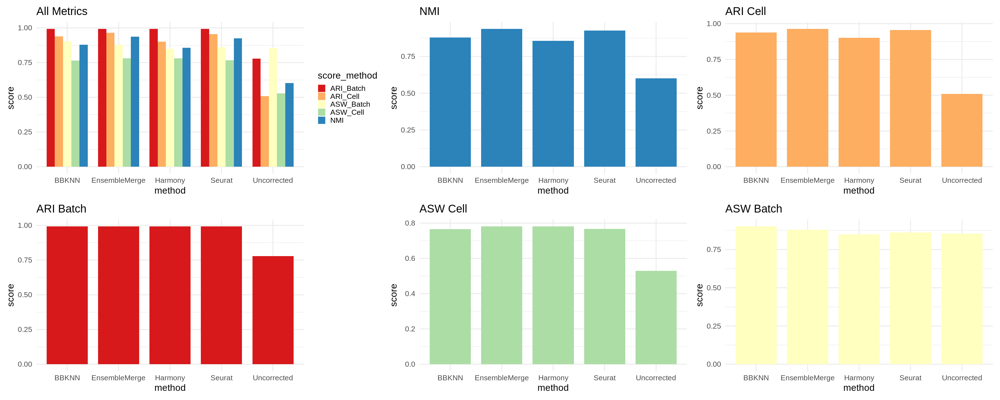

In [ ]:
#@title barplot scoring metrics
options(repr.plot.width = 30, repr.plot.height = 12)
p1 = ggplot(data = scores, aes(x = method, y = score, fill = score_method)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8) + scale_fill_brewer(palette="Spectral") + theme_minimal(base_size=20) + ggtitle((label = "All Metrics"))
p2 = ggplot(data = nmi_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#2B83BA") + theme_minimal(base_size=20) + ggtitle((label = "NMI"))
p3 = ggplot(data = ari_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FDAE61") + theme_minimal(base_size=20) + ggtitle((label = "ARI Cell"))
p4 = ggplot(data = ari_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#D7191C") + theme_minimal(base_size=20) + ggtitle((label = "ARI Batch"))
p5 = ggplot(data = asw_cell_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#ABDDA4") + theme_minimal(base_size=20) + ggtitle((label = "ASW Cell"))
p6 = ggplot(data = asw_batch_list, aes(x = method, y = score)) + geom_bar(stat = "identity", position=position_dodge(), width = 0.8, fill = "#FFFFBF") + theme_minimal(base_size=20) + ggtitle((label = "ASW Batch"))
p1 + p2 + p3 + p4 + p5 + p6

In [ ]:
BBKNN@meta.data$batch = factor(BBKNN@meta.data$batch, levels = c("celseq", "celseq2","smartseq2", "fluidigmc1",  "indrop"))

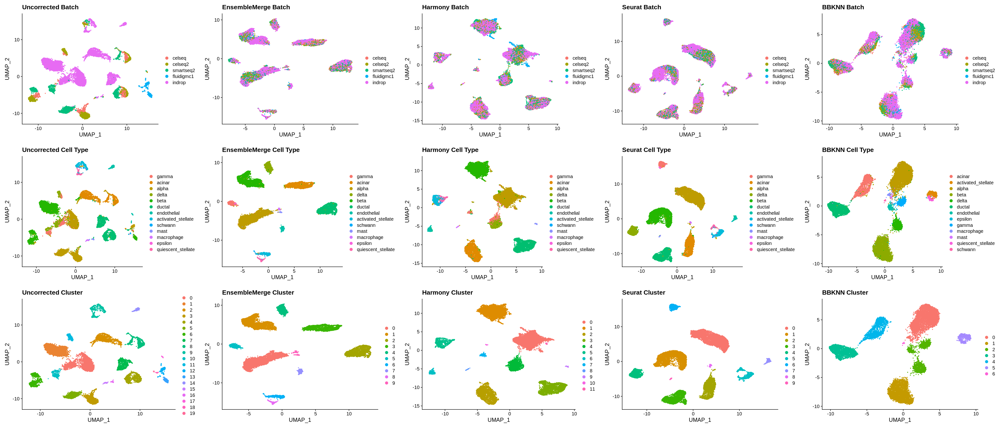

In [ ]:
#@title integration UMAP
options(repr.plot.width = 35, repr.plot.height = 15)
Seurat::Idents(uncorrected) = "batch"
p1 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Batch")
Seurat::Idents(uncorrected) = "cell_type"
p2 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cell Type")
Seurat::Idents(uncorrected) = "cluster"
p3 <- Seurat::DimPlot(uncorrected, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Uncorrected Cluster")
Seurat::Idents(test) = "batch"
p4 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Batch")
Seurat::Idents(test) = "cell_type"
p5 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cell Type")
Seurat::Idents(test) = "seurat_clusters"
p6 <- Seurat::DimPlot(test, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "EnsembleMerge Cluster")
Seurat::Idents(Harmony) = "batch"
p7 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Batch")
Seurat::Idents(Harmony) = "cell_type"
p8 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cell Type")
Seurat::Idents(Harmony) = "cluster"
p9 <- Seurat::DimPlot(Harmony, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Harmony Cluster")
Seurat::Idents(Seurat) = "batch"
p10 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Batch")
Seurat::Idents(Seurat) = "cell_type"
p11 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cell Type")
Seurat::Idents(Seurat) = "cluster"
p12 <- Seurat::DimPlot(Seurat, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "Seurat Cluster")
Seurat::Idents(BBKNN) = "batch"
p13 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Batch")
Seurat::Idents(BBKNN) = "cell_type"
p14 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cell Type")
Seurat::Idents(BBKNN) = "cluster"
p15 <- Seurat::DimPlot(BBKNN, reduction = "UMAP", pt.size = 0.5, shuffle = TRUE) + ggplot2::ggtitle(label = "BBKNN Cluster")
ggarrange(p1,p4,p7,p10,p13,p2,p5,p8,p11,p14,p3,p6,p9,p12,p15,
          ncol = 5, nrow = 3)